In [60]:
#Importing libraries
import numpy as np
import matplotlib.pyplot as plt
from scipy.linalg import eigh_tridiagonal
%matplotlib inline
import matplotlib.animation
from IPython.display import HTML, clear_output
import warnings
warnings.filterwarnings(action="error", category=np.ComplexWarning)

#Hartree atomic units decloration
h=1
el=1
a_0=1
m_e=1
E_h = 27.2 #[ev]

In [61]:
def Hamilton_matrix(a, V_vector, n):
    d = a*np.ones(n) + V_vector
    e = (-a/2)*np.ones(n-1)
    w, v = eigh_tridiagonal(d, e)
    H = np.diag(d) + np.diag(e, k=1) + np.diag(e, k=-1)
    return H, w, v.T

In [62]:
def Boundry_problem_numcalc(V_vector, dx, n):
    a = h**2 / (m_e*dx**2)
    return Hamilton_matrix(a, V_vector, n)

In [63]:
def normalization(Y_vectors, indexes):
    Y_vectors_normalized = []
    for i in indexes:
        y_sum = 0
        for m in Y_vectors[i]:
            y_sum += (np.abs(m))**2
        a = 1/(np.sqrt(y_sum*dx))
        Y_vectors_normalized.append(Y_vectors[i]*a)
    return Y_vectors_normalized

def normalization_full(Y_vectors):
    Y_vectors_normalized = []
    for i in Y_vectors:
        y_sum = 0
        for m in i:
            y_sum += (np.abs(m))**2
        a = 1/(np.sqrt(y_sum*dx))
        Y_vectors_normalized.append(i*a)
    return Y_vectors_normalized

def normalize_singular_wave(wave):
    norm = np.sum(np.abs(wave)**2) * dx
    wave /= norm**(1/2)
    return wave
    """
    w_normalized = []
    w_sum = 0
    for m in wave:
        w_sum += (np.abs(m))**2
        a = 1/(np.sqrt(w_sum*dx))
        w_normalized.append(m*a)
    """    

Problem 1 Clients test

In [64]:
m = 1
w = 1
L = 20
N = 400
x, dx = np.linspace(-L, +L, N, retstep=True)

v_infwell = 0*x
v_harmosc = 1/2*m*w**2*x**2
v_finwell = np.piecewise(x, [np.abs(x) > 2, np.abs(x) <= 2], [0, -10])
v_random = np.random.rand(N)

c:\Users\alexa\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8712 missing from current font.
  font.set_text(s, 0.0, flags=flags)
c:\Users\alexa\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8712 missing from current font.
  font.set_text(s, 0, flags=flags)


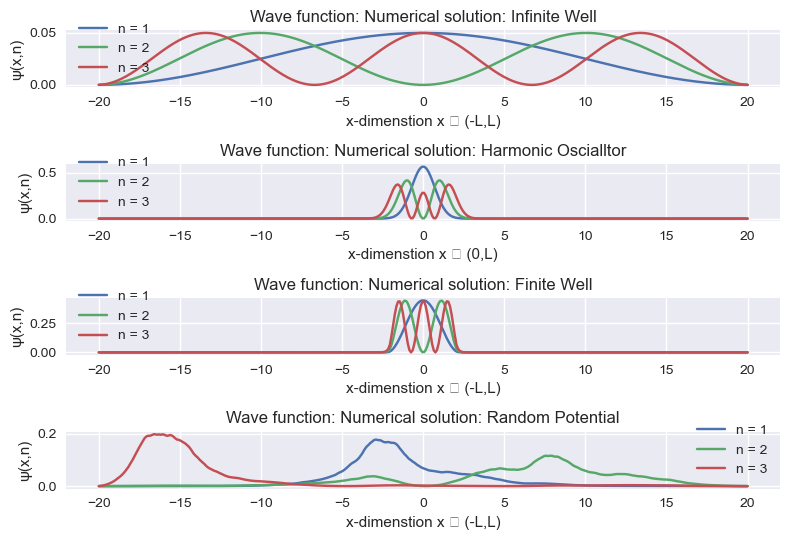

In [65]:
#numerical
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_infwell, dx, N)
Y_vectors_normalized_inf = normalization(Y_vectors, [0, 1, 2])

H, E_vals, Y_vectors = Boundry_problem_numcalc(v_harmosc, dx, N)
Y_vectors_normalized_hosc = normalization(Y_vectors, [0, 1, 2])

H, E_vals, Y_vectors = Boundry_problem_numcalc(v_finwell, dx, N)
Y_vectors_normalized_fin = normalization(Y_vectors, [0, 1, 2])

H, E_vals, Y_vectors = Boundry_problem_numcalc(v_random, dx, N)
Y_vectors_normalized_rand = normalization(Y_vectors, [0, 1, 2])

#visualisation
plt.style.use("seaborn")
plt.rcParams['figure.dpi'] = 100
fig1, (ax1, ax2, ax3, ax4) = plt.subplots(nrows = 4, ncols = 1)

ax1.plot(x, (np.abs(Y_vectors_normalized_inf[0]))**2, label = "n = 1")
ax1.plot(x, (np.abs(Y_vectors_normalized_inf[1]))**2, label = "n = 2")
ax1.plot(x, (np.abs(Y_vectors_normalized_inf[2]))**2, label = "n = 3")
ax1.set_title("Wave function: Numerical solution: Infinite Well")
ax1.set_xlabel("x-dimenstion x ∈ (-L,L)")
ax1.set_ylabel("ψ(x,n)")
ax1.legend()

ax2.plot(x, (np.abs(Y_vectors_normalized_hosc[0]))**2, label = "n = 1")
ax2.plot(x, (np.abs(Y_vectors_normalized_hosc[1]))**2, label = "n = 2")
ax2.plot(x, (np.abs(Y_vectors_normalized_hosc[2]))**2, label = "n = 3")
ax2.set_title("Wave function: Numerical solution: Harmonic Oscialltor")
ax2.set_xlabel("x-dimenstion x ∈ (0,L)")
ax2.set_ylabel("ψ(x,n)")
ax2.legend()

ax3.plot(x, (np.abs(Y_vectors_normalized_fin[0]))**2, label = "n = 1")
ax3.plot(x, (np.abs(Y_vectors_normalized_fin[1]))**2, label = "n = 2")
ax3.plot(x, (np.abs(Y_vectors_normalized_fin[2]))**2, label = "n = 3")
ax3.set_title("Wave function: Numerical solution: Finite Well")
ax3.set_xlabel("x-dimenstion x ∈ (-L,L)")
ax3.set_ylabel("ψ(x,n)")
ax3.legend()

ax4.plot(x, (np.abs(Y_vectors_normalized_rand[0]))**2, label = "n = 1")
ax4.plot(x, (np.abs(Y_vectors_normalized_rand[1]))**2, label = "n = 2")
ax4.plot(x, (np.abs(Y_vectors_normalized_rand[2]))**2, label = "n = 3")
ax4.set_title("Wave function: Numerical solution: Random Potential")
ax4.set_xlabel("x-dimenstion x ∈ (-L,L)")
ax4.set_ylabel("ψ(x,n)")
ax4.legend()

fig1.tight_layout()
plt.show()

In [66]:
#inf check
Y_n = Y_vectors_normalized_inf[0]
Y_m = Y_vectors_normalized_inf[1]
sum_1 = 0
sum_2 = 0
for i in range(0, N):
    sum_1 += Y_n[i]*Y_m[i]*dx
    sum_2 += Y_n[i]*Y_n[i]*dx
print(sum_1, sum_2)

#hosc check
Y_n = Y_vectors_normalized_hosc[0]
Y_m = Y_vectors_normalized_hosc[1]
sum_1 = 0
sum_2 = 0
for i in range(0, N):
    sum_1 += Y_n[i]*Y_m[i]*dx
    sum_2 += Y_n[i]*Y_n[i]*dx
print(sum_1, sum_2)

#fin check
Y_n = Y_vectors_normalized_fin[0]
Y_m = Y_vectors_normalized_fin[1]
sum_1 = 0
sum_2 = 0
for i in range(0, N):
    sum_1 += Y_n[i]*Y_m[i]*dx
    sum_2 += Y_n[i]*Y_n[i]*dx
print(sum_1, sum_2)

#rand check
Y_n = Y_vectors_normalized_rand[0]
Y_m = Y_vectors_normalized_rand[1]
sum_1 = 0
sum_2 = 0
for i in range(0, N):
    sum_1 += Y_n[i]*Y_m[i]*dx
    sum_2 += Y_n[i]*Y_n[i]*dx
print(sum_1, sum_2)

-2.918222262077749e-16 1.0
-4.1193623684343667e-16 0.9999999999999998
-1.3177393408492824e-14 0.9999999999999999
-3.5173092765571575e-16 1.0000000000000002


In [67]:
def coefficient_calc(mother_wave, Y_vectors_normalized):
    coefficients = []
    for j in range(0, N):
        c_j = 0
        for q in range(0, N):
            c_j += Y_vectors_normalized[j][q] * mother_wave[q] * dx
        coefficients.append(c_j)
    return coefficients

def wave_cnstrct(coefficients, Y_vectors_normalized, E_vals, t):
    wave_sum = list(np.zeros(N))
    for i in range(0, N):
        wave_sum += coefficients[i]*Y_vectors_normalized[i]*np.exp(-(1j)*E_vals[i]*t/h)
    wave_sum_n = normalize_singular_wave(wave_sum)
    return wave_sum_n

c:\Users\alexa\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8712 missing from current font.
  font.set_text(s, 0.0, flags=flags)
c:\Users\alexa\anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8712 missing from current font.
  font.set_text(s, 0, flags=flags)


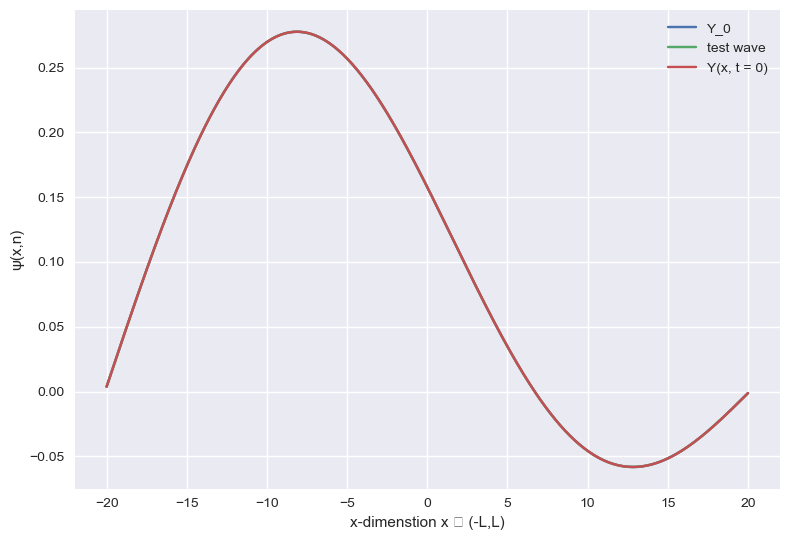

In [68]:
N = 400
L = 20
t = 0
x, dx = np.linspace(-L, +L, N, retstep=True)
v_infwell = 0*x
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_infwell, dx, N)
Y_vectors_normalized_inf = normalization_full(Y_vectors)   

def mother_wave_generator(x, t):
    m_wave = (Y_vectors_normalized_inf[0] + Y_vectors_normalized_inf[1]) / np.sqrt(2)  
    m_wave_n = normalize_singular_wave(m_wave)  
    return m_wave_n, m_wave 

mother_wave_normalized, test_wave = mother_wave_generator(x, 0)

c_n = coefficient_calc(mother_wave_normalized, Y_vectors_normalized_inf)
Y_cnstrct_normalized = wave_cnstrct(c_n, Y_vectors_normalized_inf, E_vals, t)

plt.style.use("seaborn")
plt.rcParams['figure.dpi'] = 100
fig3, (ax1) = plt.subplots(nrows = 1, ncols = 1)

ax1.plot(x, (mother_wave_normalized), label = "Y_0")
ax1.plot(x, (test_wave), label = "test wave")
ax1.plot(x, (Y_cnstrct_normalized.real), label = "Y(x, t = 0)")
ax1.set_xlabel("x-dimenstion x ∈ (-L,L)")
ax1.set_ylabel("ψ(x,n)")
ax1.legend()

fig3.tight_layout()
plt.show()

In [69]:
def animate_wave(x, v, m, wave0, wave_build, fps, t1=0, t2=None, realtime=True, real=False, imag=False):
    assert not (not realtime and t2 is None), "non-realtime animation must be finite in time"
    
    dt = 1 / fps
    nframes = None if t2 is None else int((t2 - t1) / dt) # None animates forever
    
    # print information about this animation
    nframesstr = "infinite" if t2 is None else f"{nframes}"
    durationstr = "infinite" if t2 is None else f"{t2-t1:.2f}"
    print("Animation information:")
    print(f"  Frames   : {nframesstr}")
    print(f"  Framerate: {fps} FPS")
    print(f"  Duration : {durationstr}")
    print(f"  Time step: {dt}")
    
    fig, ax = plt.subplots()
    
    # prevent duplicate animation figure in non-realtime mode
    if not realtime:
        clear_output()
        
    ax.set_xlabel("$x$")
    ax.set_ylabel("$|\Psi|$, $\Re{(\Psi)}$, $\Im{(\Psi)}$")
    
    # create objects for the graphs that will be updated every frame
    # the commas matter!
    ymax = max(np.max(np.abs(wave0)**2), np.max(np.abs(wave0)))
    graph, = ax.plot([x[0], x[-1]], [0, +2*ymax]) # plot 2x wave0 to make room
    graph4, = ax.plot([x[0], x[-1]], [0, +2*ymax]) # plot 2x wave0 to make room
    if real:
        graph2, = ax.plot([x[0], x[-1]], [0, -2*ymax]) # make room for negative values
    if imag:
        graph3, = ax.plot([x[0], x[-1]], [0, -2*ymax]) # make room for negative values
        
    
    # plot potential extended with indications of infinite walls at ends
    ax2 = ax.twinx()
    v_max = np.min(v) + 1.1 * (np.max(v) - np.min(v)) + 1 # + 1 if v = const
    x_ext = np.concatenate(([x[0]], x, [x[-1]]))
    v_ext = np.concatenate(([v_max], v, [v_max]))
    ax2.set_ylabel("$V(x)$")
    ax2.plot(x_ext, v_ext, linewidth=3, color="black", label="V")
    ax2.legend(loc="upper right")
    
    # call this function for every frame in the animation
    def animate(i):
        time = t1 + i*dt
        wave = wave_build(time) 
        
        # update graph objects
        # set_data() etc. modifies existing an existing object in a figure
        # it is much more efficient than creating a new figure for every animation frame
        graph.set_data(x, np.abs(wave))
        graph.set_label(f"$|\Psi(x, t = {time:.2f})|$")
        if real:
            graph2.set_data(x, np.real(wave))
            graph2.set_label(f"$\Re(\Psi(x, t = {time:.2f}))$")
        if imag:
            graph3.set_data(x, np.imag(wave))
            graph3.set_label(f"$\Im(\Psi(x, t = {time:.2f}))$")     
        ax.legend(loc="upper left")

        graph4.set_data(x, np.abs(wave0))
        graph4.set_label(f"$\Im(\Psi(x, t = 0)$")    

    # create matplotlib animation object
    ani = matplotlib.animation.FuncAnimation(fig, animate, frames=nframes, interval=dt*1000, repeat=False)   
    if realtime:
        return ani
    else:
        return HTML(ani.to_jshtml())

Animation Problem 1

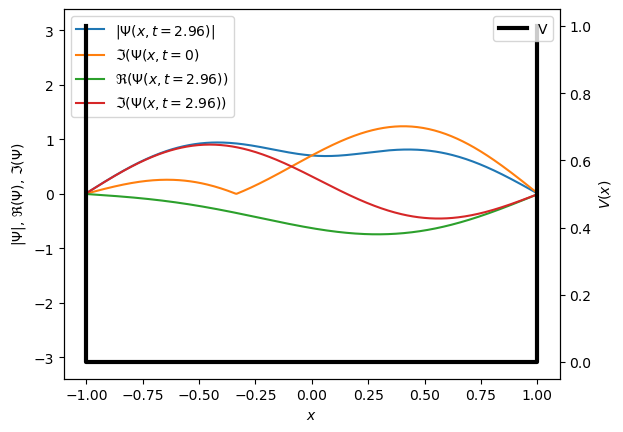

In [70]:
N = 400
L = 1
t = 0
x, dx = np.linspace(-L, +L, N, retstep=True)
v_infwell = 0*x
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_infwell, dx, N)
Y_vectors_normalized_inf = normalization_full(Y_vectors)  

def mother_wave_generator(x, t):
    m_wave = (Y_vectors_normalized_inf[0] + Y_vectors_normalized_inf[1]) / np.sqrt(2)  
    m_wave_n = normalize_singular_wave(m_wave)  
    return m_wave_n, m_wave 
mother_wave_normalized, test_wave = mother_wave_generator(x, 0)

c_n = coefficient_calc(mother_wave_normalized, Y_vectors_normalized_inf)

def wave_build_inf (time):
    return wave_cnstrct(c_n, Y_vectors_normalized_inf, E_vals, time)

plt.style.use('default')
animate_wave(x, v_infwell, m, mother_wave_normalized, wave_build_inf, 25, t2=3, realtime=False, real=True, imag=True)

Animation Problem 2

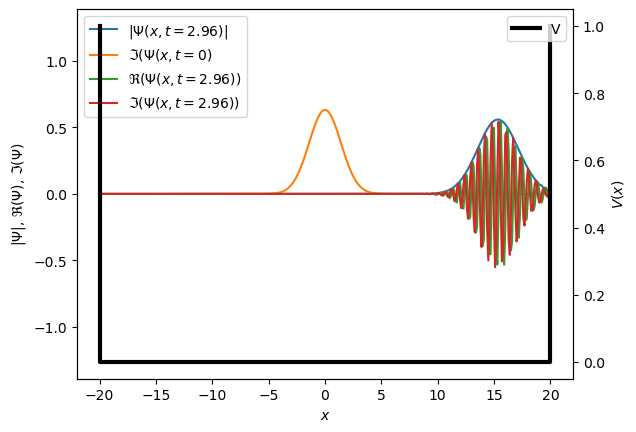

In [71]:
N = 400
L = 20
t = 0
x, dx = np.linspace(-L, +L, N, retstep=True)
v_infwell = 0*x
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_infwell, dx, N)
Y_vectors_normalized_inf = normalization_full(Y_vectors)  

def mother_wave_generator(x, t):
    x_0 = 0 #expected value, choose middle value on x (0)
    p_0 = 10 # expected value of p 
    DX = 1
    DP = (h/2) / (DX)    
    m_wave = (2*np.pi*DX**2)**(-1/4) * np.exp((-(x-x_0)**2) / (4*DX**2))*np.exp(1j*p_0*x/h)  
    m_wave_n = normalize_singular_wave(m_wave)  
    return m_wave_n, m_wave 
mother_wave_normalized, test_wave = mother_wave_generator(x, 0)

c_n = coefficient_calc(mother_wave_normalized, Y_vectors_normalized_inf)

def wave_build_inf (time):
    return wave_cnstrct(c_n, Y_vectors_normalized_inf, E_vals, time)
    
animate_wave(x, v_infwell, m, mother_wave_normalized, wave_build_inf, 25, t2=3, realtime=False, real=True, imag=True)

Animation Problem 3

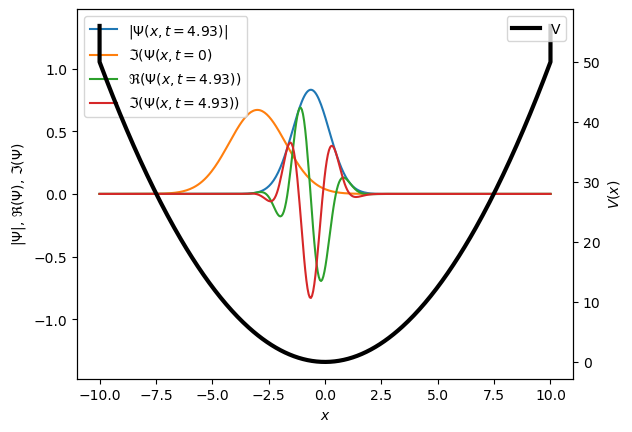

In [72]:
N = 400
L = 10
t = 0
x, dx = np.linspace(-L, +L, N, retstep=True)
v_harmosc = 1/2*m*w**2*x**2
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_harmosc, dx, N)
Y_vectors_normalized_inf = normalization_full(Y_vectors)  

def mother_wave_generator(x, t):
    x_0 = -3 #expected value, choose middle value on x (0)
    p_0 = 10 # expected value of p 
    DX = 1
    DP = (h/2) / (DX)    
    omega = 1
    m_wave = (m_e*omega / np.pi*h)**(1/4)*np.exp(-m_e*omega*((x-x_0)**2) / (np.pi*h))
    m_wave_n = normalize_singular_wave(m_wave)  
    return m_wave_n, m_wave 
mother_wave_normalized, test_wave = mother_wave_generator(x, 0)

c_n = coefficient_calc(mother_wave_normalized, Y_vectors_normalized_inf)

def wave_build_inf (time):
    return wave_cnstrct(c_n, Y_vectors_normalized_inf, E_vals, time)
    
animate_wave(x, v_harmosc, m, mother_wave_normalized, wave_build_inf, 15, t2=5, realtime=False, real=True, imag=True)

Animation Problem 4

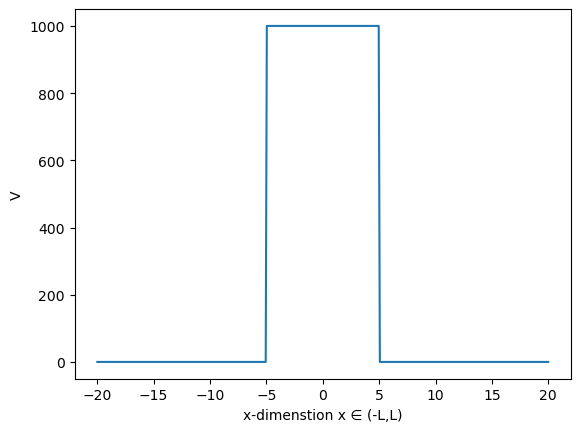

In [90]:
#constructing barrier
barrier = 1000
v_barrier = np.zeros(150)
v_barrier = np.append(v_barrier, np.ones(100)*barrier)
v_barrier = np.append(v_barrier, np.zeros(150))
v_gauss = list(v_barrier)

fig4, (ax1) = plt.subplots(nrows = 1, ncols = 1)
ax1.plot(x, v_barrier, label = "potential")
ax1.set_xlabel("x-dimenstion x ∈ (-L,L)")
ax1.set_ylabel("V")
fig3.tight_layout()
plt.show()

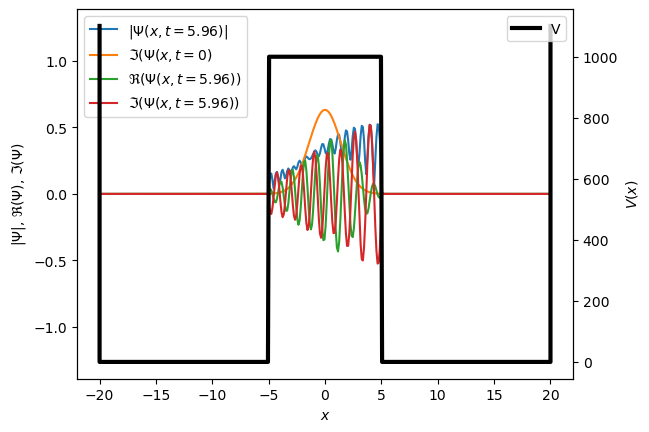

In [91]:
N = 400
L = 20
t = 0
x, dx = np.linspace(-L, +L, N, retstep=True)
H, E_vals, Y_vectors = Boundry_problem_numcalc(v_barrier, dx, N)
Y_vectors_normalized_inf = normalization_full(Y_vectors)  

def mother_wave_generator(x, t):
    x_0 = 0 #expected value, choose middle value on x (0)
    p_0 = 5 # expected value of p 
    DX = 1
    DP = (h/2) / (DX)    
    m_wave = (2*np.pi*DX**2)**(-1/4) * np.exp((-(x-x_0)**2) / (4*DX**2))*np.exp(1j*p_0*x/h)  
    m_wave_n = normalize_singular_wave(m_wave)  
    return m_wave_n, m_wave 
mother_wave_normalized, test_wave = mother_wave_generator(x, 0)

c_n = coefficient_calc(mother_wave_normalized, Y_vectors_normalized_inf)

def Mean_E(c_n, E_n):
    mean_E = 0
    for i in range(len(c_n)):
        mean_E += (np.abs(c_n[i]))**2*E_n[i]
    return mean_E
mean_E = Mean_E(c_n, E_vals)

def wave_build_inf (time):
    return wave_cnstrct(c_n, Y_vectors_normalized_inf, E_vals, time)
    
animate_wave(x, v_barrier, m, mother_wave_normalized, wave_build_inf, 25, t2=6, realtime=False, real=True, imag=True)